In [1]:
#%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd
import pysal as ps
import re
from geopandas import GeoDataFrame
from shapely.geometry import Point
#from pysal.contrib.viz import mapping as maps
import scipy.stats as stats
from datetime import datetime as dt
import time
# plotting stuff
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('bmh')
plt.rcParams['figure.figsize'] = (12.0, 12.0)
import matplotlib
#font = {'family' : 'normal',
#        'weight' : 'normal',
#        'size'   : 14}
#matplotlib.rc('font', **font)
from matplotlib.colors import LogNorm
# widget stuff
from ipywidgets import interact, HTML, FloatSlider
from IPython.display import clear_output, display
import warnings
# embedding stuff
import plotly.graph_objs as go
import plotly
import plotly.express as px
import chart_studio
import altair as alt
import datapane
import seaborn as sns

In [2]:
df = pd.read_csv("data/allegations_202007271729.csv")

In [3]:
df

,unique_mos_id,first_name,last_name,command_now,shield_no,complaint_id,month_received,year_received,month_closed,year_closed,...,mos_age_incident,complainant_ethnicity,complainant_gender,complainant_age_incident,fado_type,allegation,precinct,contact_reason,outcome_description,board_disposition
0,10004,Jonathan,Ruiz,078 PCT,8409,42835,7,2019,5,2020,...,32,Black,Female,38.0,Abuse of Authority,Failure to provide RTKA card,78.0,Report-domestic dispute,No arrest made or summons issued,Substantiated (Command Lvl Instructions)
1,10007,John,Sears,078 PCT,5952,24601,11,2011,8,2012,...,24,Black,Male,26.0,Discourtesy,Action,67.0,Moving violation,Moving violation summons issued,Substantiated (Charges)
2,10007,John,Sears,078 PCT,5952,24601,11,2011,8,2012,...,24,Black,Male,26.0,Offensive Language,Race,67.0,Moving violation,Moving violation summons issued,Substantiated (Charges)
3,10007,John,Sears,078 PCT,5952,26146,7,2012,9,2013,...,25,Black,Male,45.0,Abuse of Authority,Question,67.0,PD suspected C/V of violation/crime - street,No arrest made or summons issued,Substantiated (Charges)
4,10009,Noemi,Sierra,078 PCT,24058,40253,8,2018,2,2019,...,39,NaN,NaN,16.0,Force,Physical force,67.0,Report-dispute,Arrest - other violation/crime,Substantiated (Command Discipline A)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33353,9992,Tomasz,Pulawski,078 PCT,2642,35671,8,2016,2,2017,...,36,Asian,Male,21.0,Discourtesy,Word,66.0,Moving violation,Moving violation summons issued,Unsubstantiated
33354,9992,Tomasz,Pulawski,078 PCT,2642,35671,8,2016,2,2017,...,36,Asian,Male,21.0,Abuse of Authority,Interference with recording,66.0,Moving violation,Moving violation summons issued,Unsubstantiated
33355,9992,Tomasz,Pulawski,078 PCT,2642,35671,8,2016,2,2017,...,36,Asian,Male,21.0,Abuse of Authority,Search (of person),66.0,Moving violation,Moving violation summons issued,Substantiated (Formalized Training)
33356,9992,Tomasz,Pulawski,078 PCT,2642,35671,8,2016,2,2017,...,36,Asian,Male,21.0,Abuse of Authority,Vehicle search,66.0,Moving violation,Moving violation summons issued,Substantiated (Formalized Training)


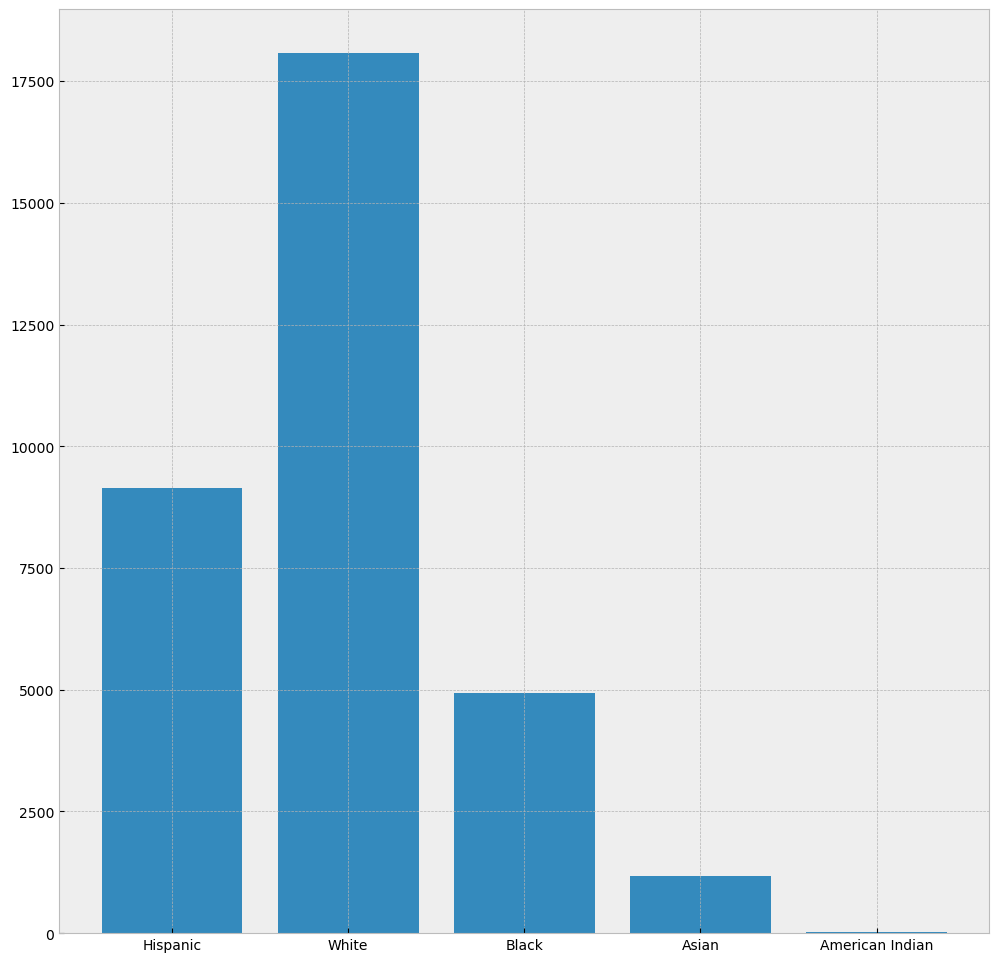

In [4]:
temp = df['mos_ethnicity'].unique()

temp_ar = np.zeros(len(temp))
for i in range(len(temp)):
    temp_ar[i] = np.sum(df['mos_ethnicity']==temp[i])

plt.bar(np.arange(len(temp)), temp_ar)
plt.xticks(np.arange(len(temp)), temp)

pass

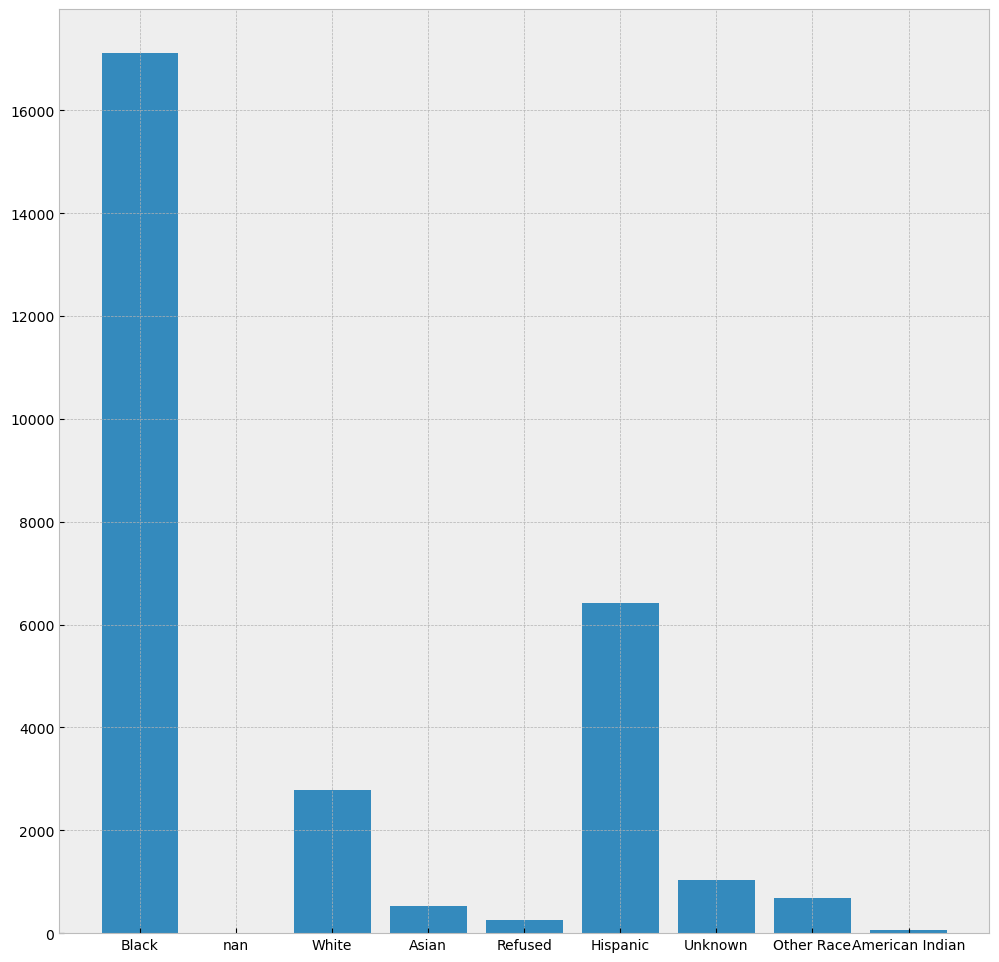

In [5]:
temp = df['complainant_ethnicity'].unique()

temp_ar = np.zeros(len(temp))
for i in range(len(temp)):
    temp_ar[i] = np.sum(df['complainant_ethnicity']==temp[i])

plt.bar(np.arange(len(temp)), temp_ar)
plt.xticks(np.arange(len(temp)), temp)

pass

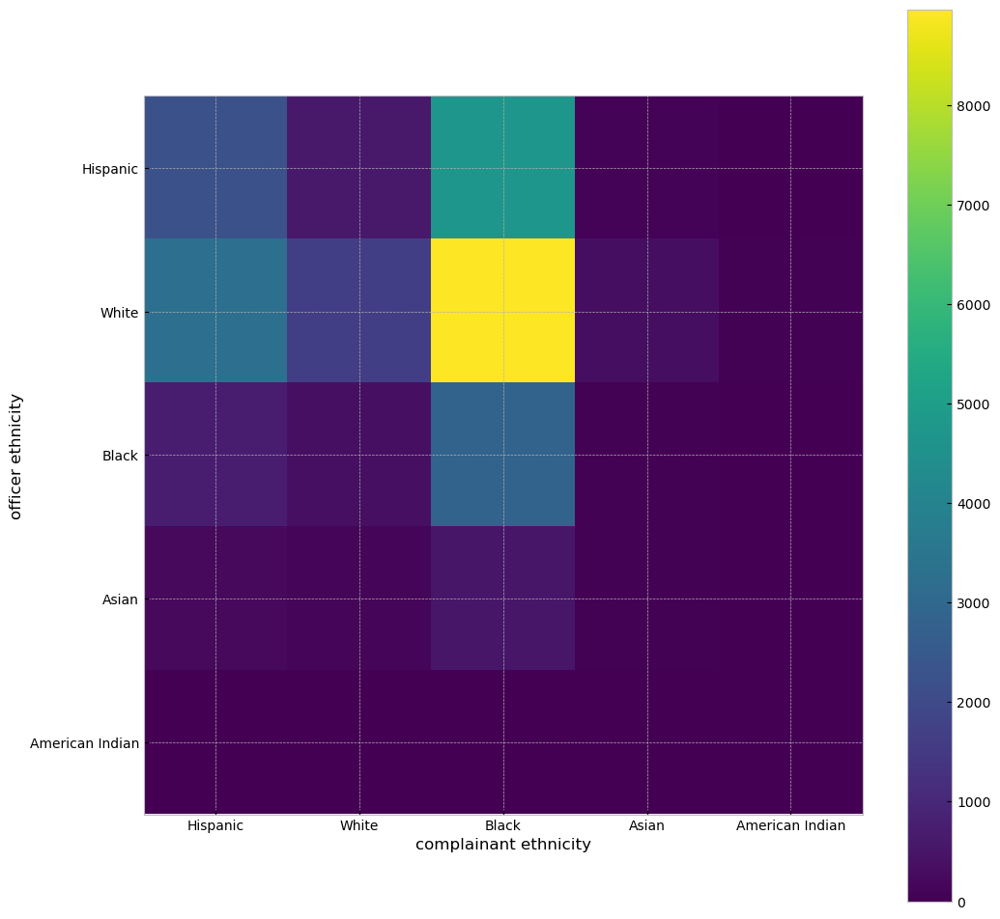

In [27]:
temp = df['mos_ethnicity'].unique()

temp_mat = np.zeros([len(temp), len(temp)])
for i in range(len(temp)):
    for j in range(len(temp)):
        temp_mat[i,j] = np.sum(np.array(df['mos_ethnicity']==temp[i]) * np.array(df['complainant_ethnicity'] == temp[j]))

from matplotlib.colors import LogNorm

plt.imshow(temp_mat, vmin=0)#, norm=LogNorm())
plt.colorbar()
plt.ylabel('officer ethnicity')
plt.xlabel('complainant ethnicity')
plt.xticks(np.arange(len(temp)),temp)
plt.yticks(np.arange(len(temp)),temp)

pass

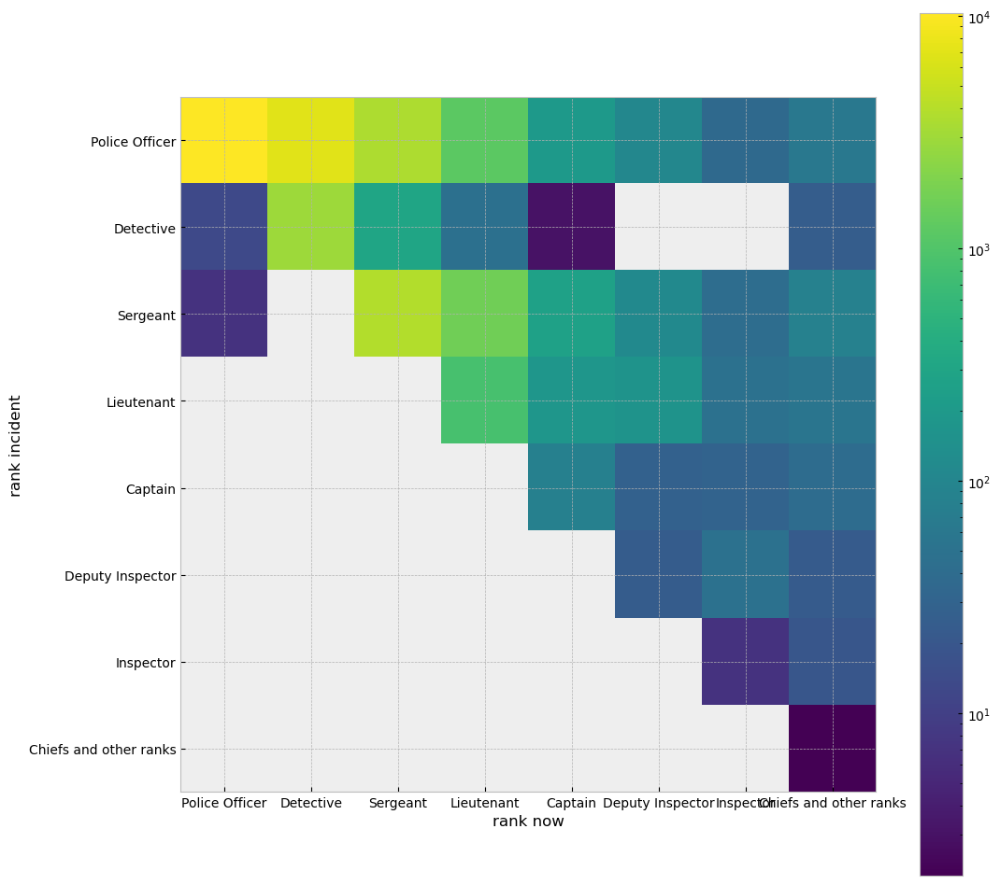

In [41]:
rank = {}
rank['Police Officer'] = 0
rank['Detective'] = 1
rank['Sergeant'] = 2
rank['Lieutenant'] = 3
rank['Captain'] = 4
rank['Deputy Inspector'] = 5
rank['Inspector'] = 6
rank['Chiefs and other ranks'] = 7

ranks = list(rank.keys())
temp_mat = np.zeros([len(ranks), len(ranks)])
for i in range(len(ranks)):
    for j in range(len(ranks)):
        temp_mat[i,j] = np.sum(np.array(df['rank_incident']==ranks[i]) * np.array(df['rank_now'] == ranks[j]))

from matplotlib.colors import LogNorm

plt.imshow(temp_mat, norm=LogNorm())
plt.colorbar()
plt.ylabel('rank incident')
plt.xlabel('rank now')
plt.xticks(np.arange(len(ranks)),ranks)
plt.yticks(np.arange(len(ranks)),ranks)

pass


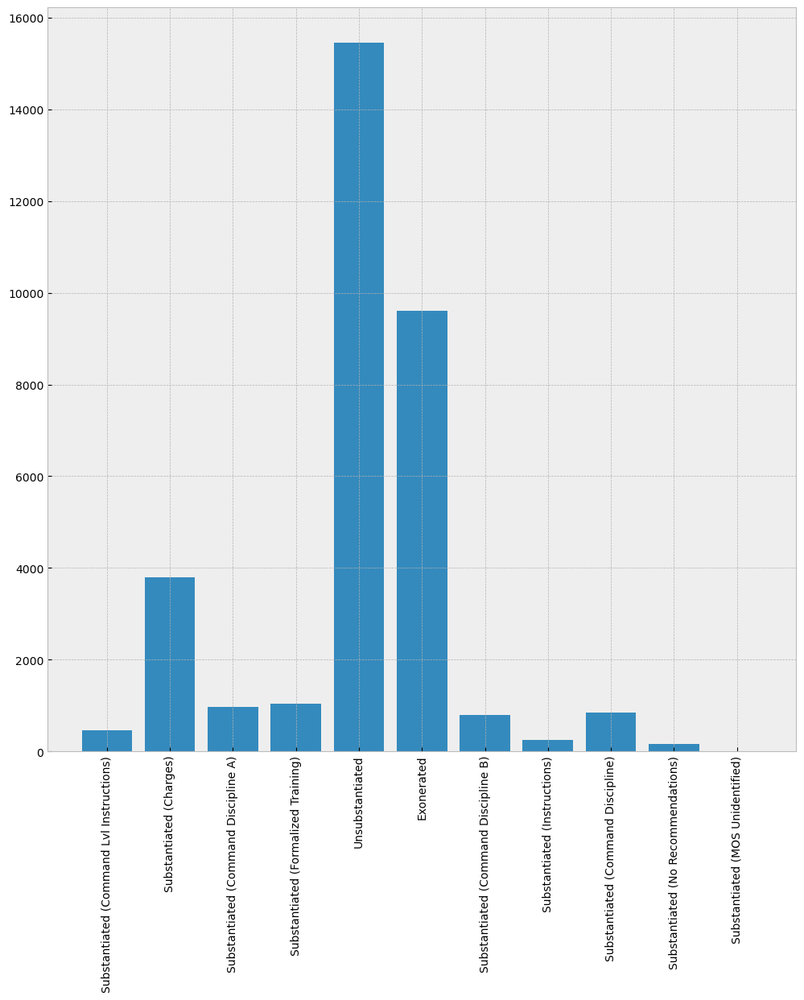

In [38]:
temp = df['board_disposition'].unique()
temp_ar = np.zeros(len(temp))
for i in range(len(temp)):
    temp_ar[i] = np.sum(df['board_disposition']==temp[i])

plt.bar(np.arange(len(temp)), temp_ar)
plt.xticks(np.arange(len(temp)), temp, rotation=90)

pass

In [44]:
df['fado_type'].unique()

array(['Abuse of Authority', 'Discourtesy', 'Offensive Language', 'Force'],
      dtype=object)

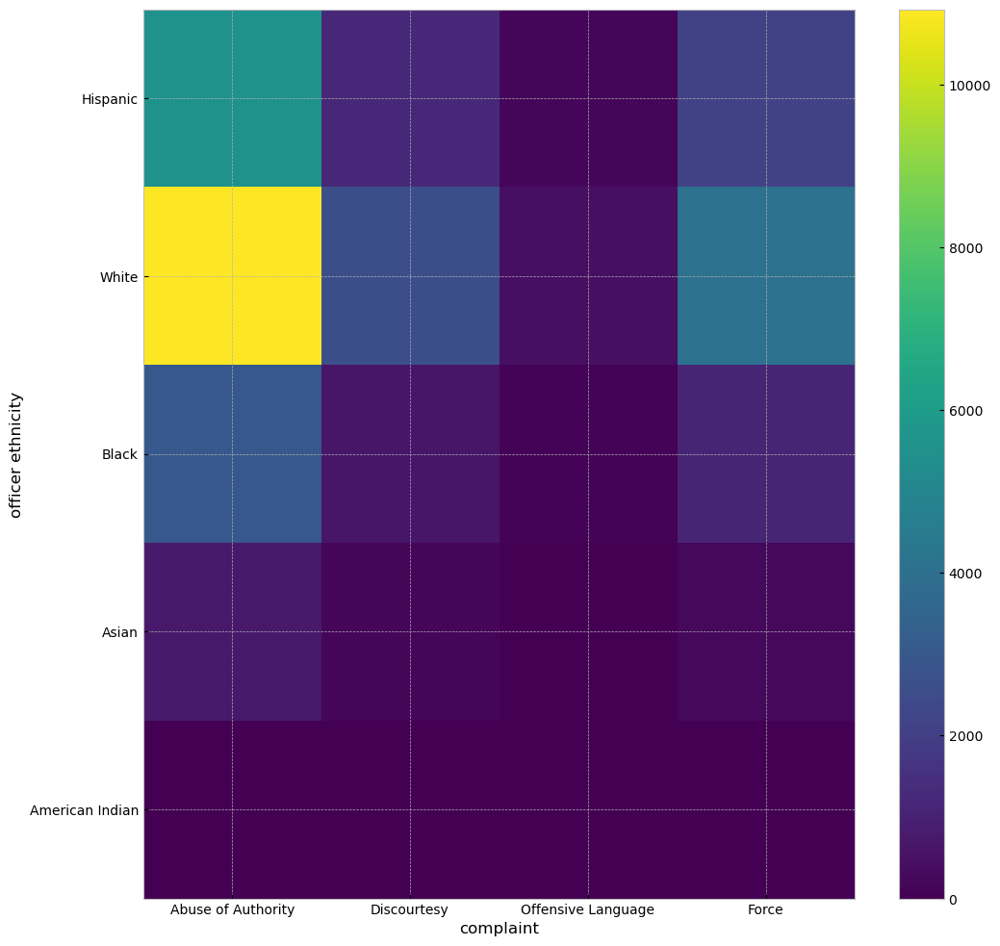

In [51]:
temp1 = df['mos_ethnicity'].unique()
temp2 = df['fado_type'].unique()
temp_mat = np.zeros([len(temp1), len(temp2)])
for i in range(len(temp1)):
    for j in range(len(temp2)):
        temp_mat[i,j] = np.sum(np.array(df['mos_ethnicity']==temp1[i]) * np.array(df['fado_type'] == temp2[j]))

from matplotlib.colors import LogNorm

plt.imshow(temp_mat, vmin=0)#, norm=LogNorm())
plt.colorbar()
plt.ylabel('officer ethnicity')
plt.xlabel('complaint')
plt.yticks(np.arange(len(temp1)),temp1)
plt.xticks(np.arange(len(temp2)),temp2)

pass

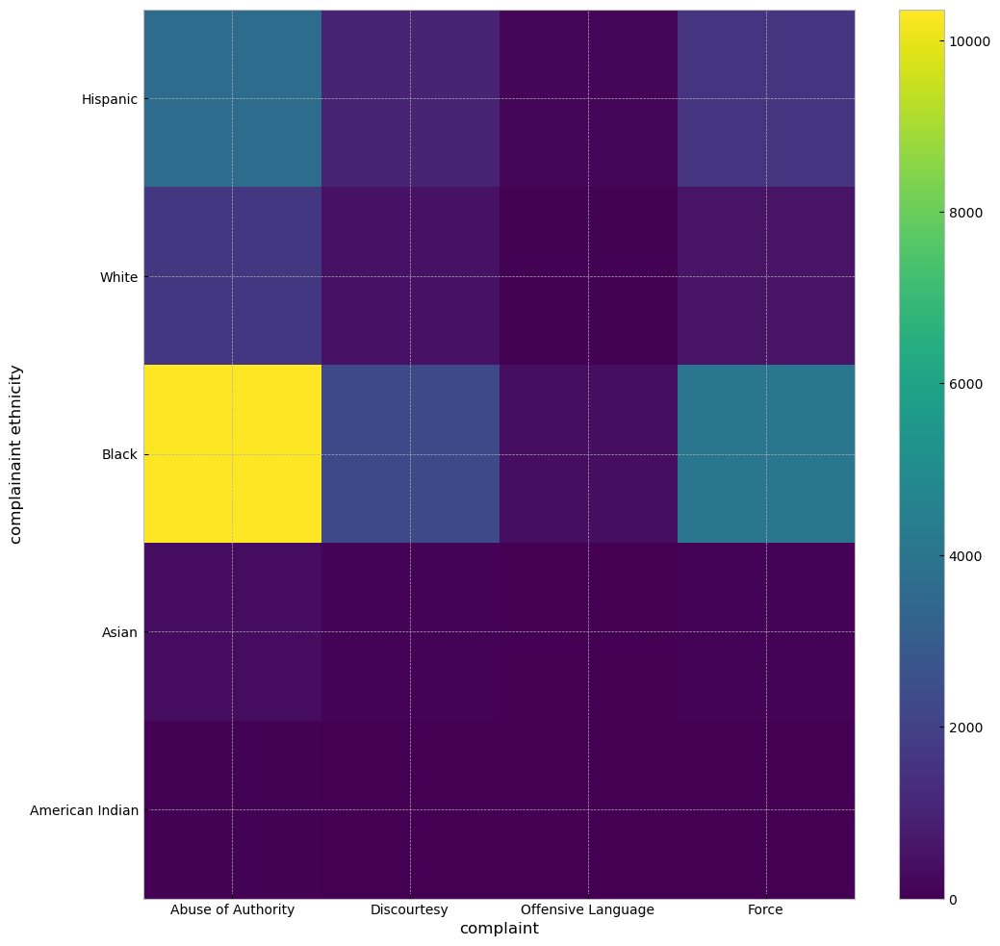

In [53]:
temp1 = df['mos_ethnicity'].unique()
temp2 = df['fado_type'].unique()
temp_mat = np.zeros([len(temp1), len(temp2)])
for i in range(len(temp1)):
    for j in range(len(temp2)):
        temp_mat[i,j] = np.sum(np.array(df['complainant_ethnicity']==temp1[i]) * np.array(df['fado_type'] == temp2[j]))

from matplotlib.colors import LogNorm

plt.imshow(temp_mat, vmin=0)#, norm=LogNorm())
plt.colorbar()
plt.ylabel('complainaint ethnicity')
plt.xlabel('complaint')
plt.yticks(np.arange(len(temp1)),temp1)
plt.xticks(np.arange(len(temp2)),temp2)

pass

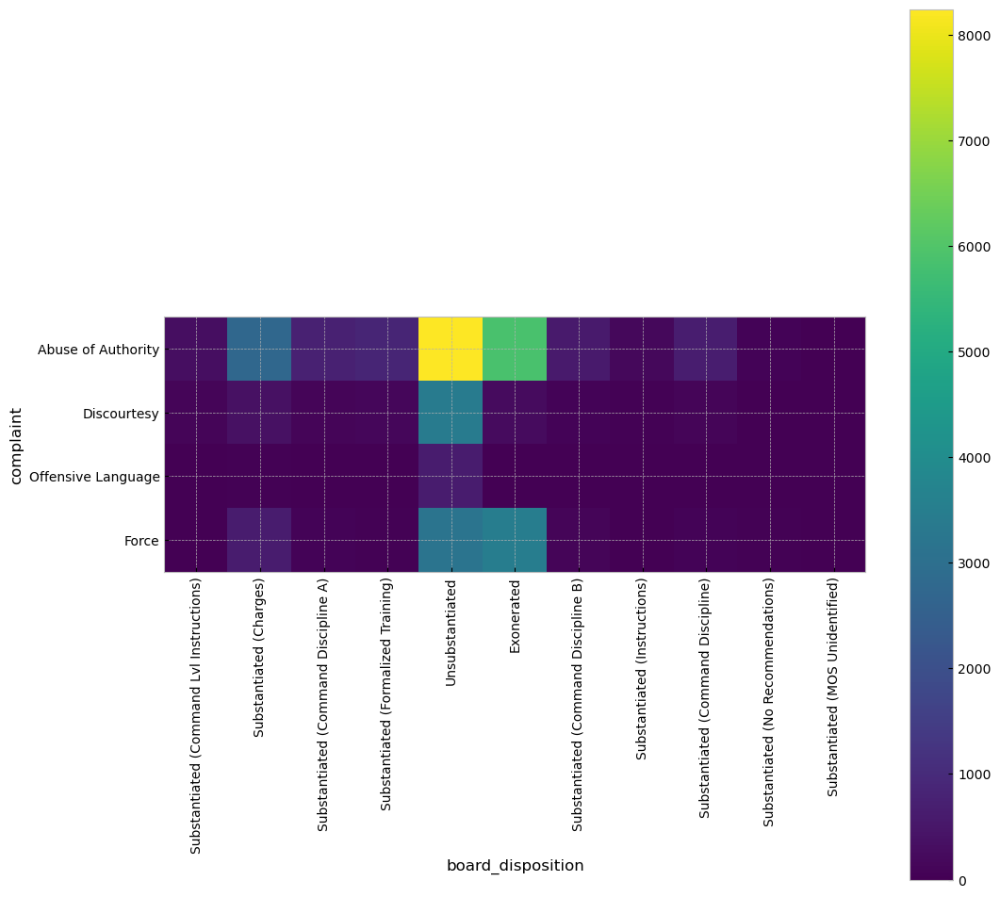

In [59]:
temp1 = df['board_disposition'].unique()
temp2 = df['fado_type'].unique()
temp_mat = np.zeros([len(temp2), len(temp1)])
for i in range(len(temp1)):
    for j in range(len(temp2)):
        temp_mat[j,i] = np.sum(np.array(df['board_disposition']==temp1[i]) * np.array(df['fado_type'] == temp2[j]))

from matplotlib.colors import LogNorm

plt.imshow(temp_mat, vmin=0)#, norm=LogNorm())
plt.colorbar()
plt.xlabel('board_disposition')
plt.ylabel('complaint')
plt.xticks(np.arange(len(temp1)),temp1, rotation=90)
plt.yticks(np.arange(len(temp2)),temp2)

pass

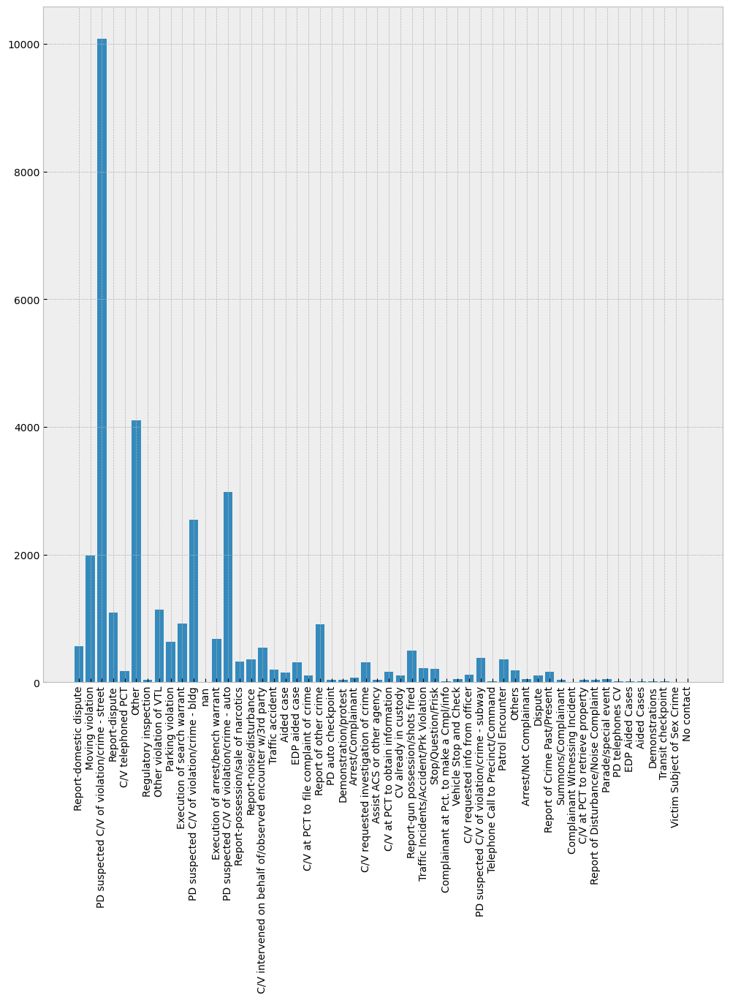

In [72]:
temp = df['contact_reason'].unique()
temp_ar = np.zeros(len(temp))
for i in range(len(temp)):
    temp_ar[i] = np.sum(df['contact_reason']==temp[i])

plt.bar(np.arange(len(temp)), temp_ar)
plt.xticks(np.arange(len(temp)), temp, rotation=90)

pass

C:\Users\Nicole\AppData\Local\Temp\ipykernel_8752\4277133724.py:11: RuntimeWarning: invalid value encountered in divide
  plt.plot(xvec, yvec2/yvec)


Text(0, 0.5, 'complaints')

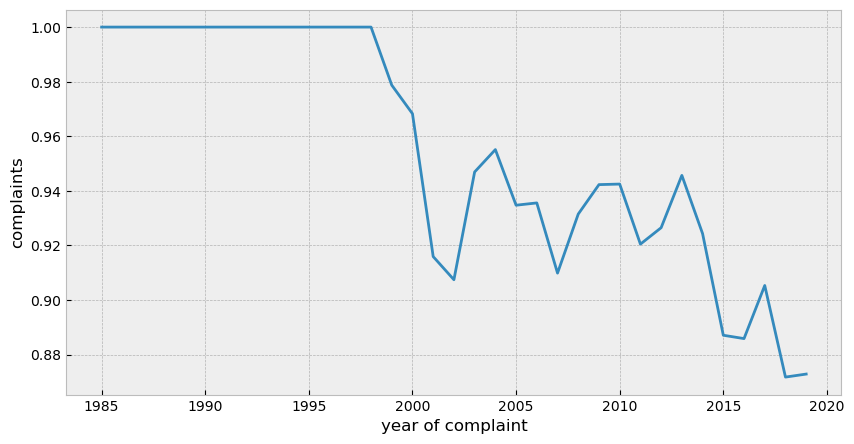

In [661]:
#y = 'contact_reason'
plt.figure(figsize=(10,5))
x = 'year_received'
xvec = list(set(df[x].unique()))
yvec = np.zeros(len(xvec))
yvec2 = np.zeros(len(xvec))
for i in range(len(yvec)):
    yvec[i] = np.sum(np.array(df[x] == xvec[i])*np.array(df['fado_type']=='Force'))
    yvec2[i] = np.sum(np.array(df[x] == xvec[i])*np.array(df['fado_type']=='Force')*np.array(df['complainant_ethnicity']!='White'))

plt.plot(xvec, yvec2/yvec)

plt.xlabel('year of complaint')
plt.ylabel("complaints")

In [670]:
df.loc[df['year_received']<1999].complainant_ethnicity.unique()

array([nan, 'Black', 'Hispanic'], dtype=object)

In [ ]:
#y = 'contact_reason'
plt.figure(figsize=(10,5))
x = 'year_received'
xvec = list(set(df[x].unique()))
yvec = np.zeros(len(xvec))
yvec2 = np.zeros(len(xvec))
for i in range(len(yvec)):
    yvec[i] = np.sum(np.array(df[x] == xvec[i])*np.array(df['fado_type']=='Force'))
    yvec2[i] = np.sum(np.array(df[x] == xvec[i])*np.array(df['fado_type']=='Force')*np.array(df['complainant_ethnicity']!='White'))

plt.plot(xvec, yvec2/yvec)

plt.xlabel('year of complaint')
plt.ylabel("complaints")

Text(0, 0.5, 'complaints')

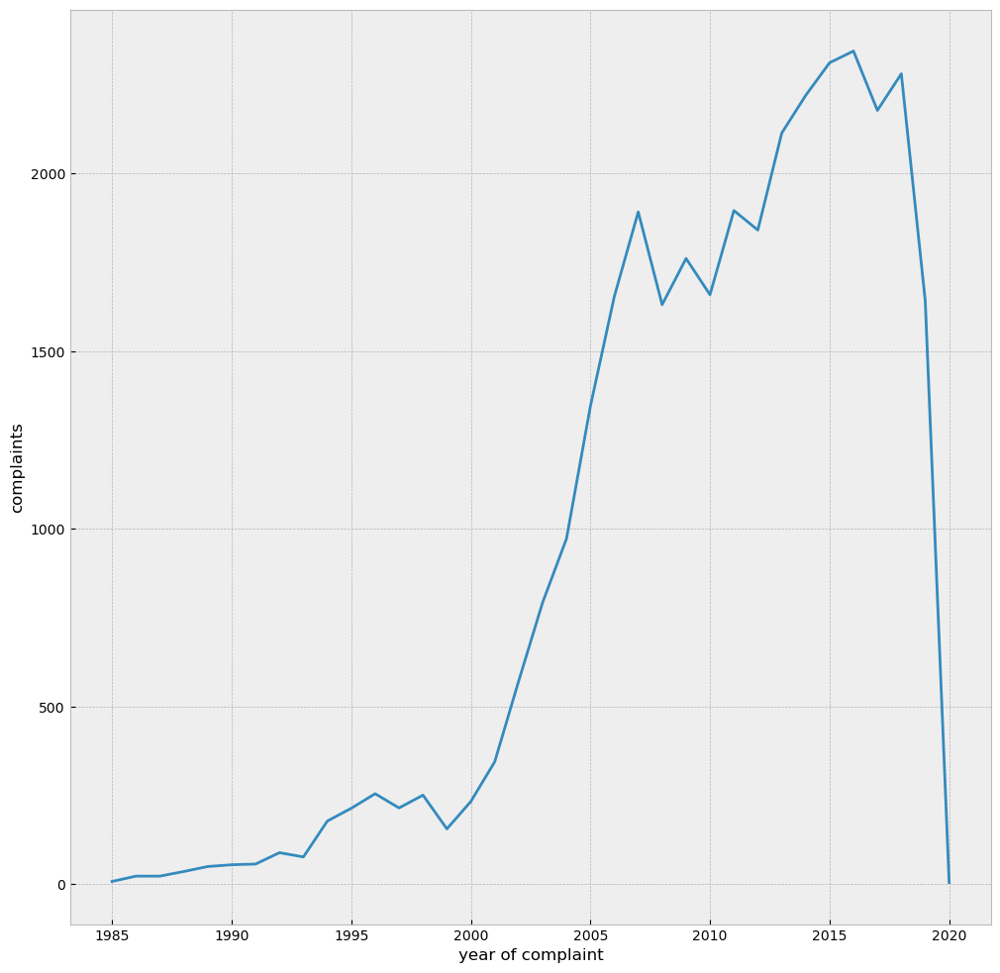

In [76]:
#y = 'contact_reason'
x = 'year_received'
xvec = list(set(df[x].unique()))
yvec = np.zeros(len(xvec))
for i in range(len(yvec)):
    yvec[i] = np.sum(np.array(df[x] == xvec[i]))

plt.plot(xvec, yvec)
plt.xlabel('year of complaint')
plt.ylabel("complaints")

In [ ]:

fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.set_xlabel('time (s)')
ax1.set_ylabel('exp', color=color)
ax1.plot(t, data1, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('sin', color=color)  # we already handled the x-label with ax1
ax2.plot(t, data2, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped

In [225]:
df['fado_type'].unique()

array(['Abuse of Authority', 'Discourtesy', 'Offensive Language', 'Force'],
      dtype=object)

In [ ]:
'Search (of person)'

In [251]:
df.loc[df['fado_type']=='Force']['allegation'].unique()

array(['Physical force', 'Pepper spray', 'Handcuffs too tight',
       'Hit against inanimate object', 'Nonlethal restraining device',
       'Chokehold', 'Other', 'Nightstick as club (incl asp & baton)',
       'Gun Pointed', 'Other blunt instrument as a club', 'Other - Force',
       'Vehicle', 'Dragged/Pulled', 'Push/Shove', 'Mace',
       'Restricted Breathing', 'Flashlight as club', 'Gun as club',
       'Radio As Club', 'Nightstick/Billy/Club', 'Punch/Kick', 'Beat',
       'Gun fired', 'Flashlight As Club', 'Radio as club', nan, 'Slap',
       'Gun As Club', 'Police shield', 'Animal', 'Gun Fired'],
      dtype=object)

In [260]:
df.loc[df['fado_type']=='Abuse of Authority']['allegation'].unique()[20:-1]

array(['Retaliatory arrest', 'Seizure of property',
       'Refusal to provide name', 'Threat to notify ACS',
       'Property damaged', 'Interference with recording',
       'Refusal to show search warrant',
       'Threat to damage/seize property',
       'Sex Miscon (Sexual Harassment, Verbal)',
       'Sex Miscon (Sexual Harassment, Gesture)',
       'Forcible Removal to Hospital', 'Entry of Premises',
       'Threat of summons', 'Search of Premises',
       'Threat re: removal to hospital', 'Photography/Videography',
       'Detention', 'Body Cavity Searches',
       'Electronic device information deletion',
       'Search of recording device', 'Threat of force',
       'Property Damaged', 'Other - Abuse', 'Property Seized',
       'Threat to Property', 'Sexual Misconduct (Sexual Humiliation)',
       'Threat of Arrest', 'Sex Miscon (Sexual/Romantic Proposition)',
       'Gun pointed/gun drawn', 'Improper dissemination of medical info',
       'Person Searched', 'Arrest/Onlooker',

In [264]:
gun = []
force = []
frisk = []
for i in df.loc[df['fado_type']=='Abuse of Authority']['allegation'].unique():
    if 'gun' in i or 'Gun' in i:
        print('gun', i)
        gun.append(i)
    if 'forc' in i or 'Forc' in i:
        print('force', i)
        force.append(i)
    if 'search' in i or 'Search' in i or "Frisk" in i or "frisk" in i:
        print('frisk', i)
        frisk.append(i)

power_force = []
power_force.extend(gun); power_force.extend(force); power_force.extend(frisk)

frisk Search (of person)
frisk Frisk
frisk Vehicle search
frisk Strip-searched
force Threat of force (verbal or physical)
frisk Frisk and/or search
frisk Premises entered and/or searched
gun Gun Drawn
frisk Refusal to show search warrant
force Forcible Removal to Hospital
frisk Search of Premises
frisk Body Cavity Searches
frisk Search of recording device
force Threat of force
gun Gun pointed/gun drawn
frisk Person Searched
frisk Vehicle Searched
frisk Premise Searched
gun Gun pointed


In [287]:
df.loc[df['allegation']=='Person Searched']['']

,unique_mos_id,first_name,last_name,command_now,shield_no,complaint_id,month_received,year_received,month_closed,year_closed,...,mos_age_incident,complainant_ethnicity,complainant_gender,complainant_age_incident,fado_type,allegation,precinct,contact_reason,outcome_description,board_disposition
3984,15188,Peter,Ievolo,120 PCT,1517,860,5,1989,5,1989,...,31,NaN,NaN,NaN,Abuse of Authority,Person Searched,70.0,Patrol Encounter,No arrest made or summons issued,Unsubstantiated
4730,16150,Michael,Cronin,BARRIER,348,3479,11,1998,6,2000,...,30,Black,Male,47.0,Abuse of Authority,Person Searched,46.0,NaN,No arrest made or summons issued,Unsubstantiated
4902,16187,Steven,Smolarsky,BK SVS,3621,2932,10,1997,10,1997,...,26,NaN,NaN,NaN,Abuse of Authority,Person Searched,108.0,Traffic Incidents/Accident/Prk Violation,No arrest made or summons issued,Unsubstantiated
5446,16843,Mark,Kurys,C R C,3373,3620,2,1999,2,1999,...,24,NaN,NaN,NaN,Abuse of Authority,Person Searched,50.0,Vehicle Stop and Check,No arrest made or summons issued,Substantiated (Charges)
5783,17380,Paul,Rodriguez,CD OFF,4813,2818,7,1997,7,1997,...,27,NaN,NaN,NaN,Abuse of Authority,Person Searched,67.0,Traffic Incidents/Accident/Prk Violation,No arrest made or summons issued,Substantiated (Command Discipline)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27549,4231,Joseph,Hayes,043 PCT,15858,2758,5,1997,5,1997,...,29,NaN,NaN,NaN,Abuse of Authority,Person Searched,43.0,Stop/Question/Frisk,No arrest made or summons issued,Substantiated (Instructions)
27687,4440,Norberto,Tirado,044 DET,6650,3202,4,1998,4,1998,...,34,NaN,NaN,NaN,Abuse of Authority,Person Searched,43.0,Stop/Question/Frisk,No arrest made or summons issued,Substantiated (Charges)
28324,5022,Richard,Brea,046 PCT,0,2547,10,1996,10,1996,...,24,NaN,NaN,NaN,Abuse of Authority,Person Searched,75.0,Stop/Question/Frisk,Harrassment/Arrested/Summons,Substantiated (Charges)
30492,7147,Peter,Rhatigan,063 PCT,29658,2506,9,1996,9,1996,...,27,NaN,NaN,NaN,Abuse of Authority,Person Searched,79.0,Report of Crime Past/Present,No arrest made or summons issued,Exonerated


In [290]:
temp = np.zeros(len(df))
for i in range(len(power_force)):
    temp += df['allegation']==power_force[i]

new_force = np.array(temp, dtype='bool')

temp = np.zeros(len(df))
for i in range(len(frisk)):
    temp += df['allegation']==frisk[i]

new_frisk = np.array(temp, dtype='bool')

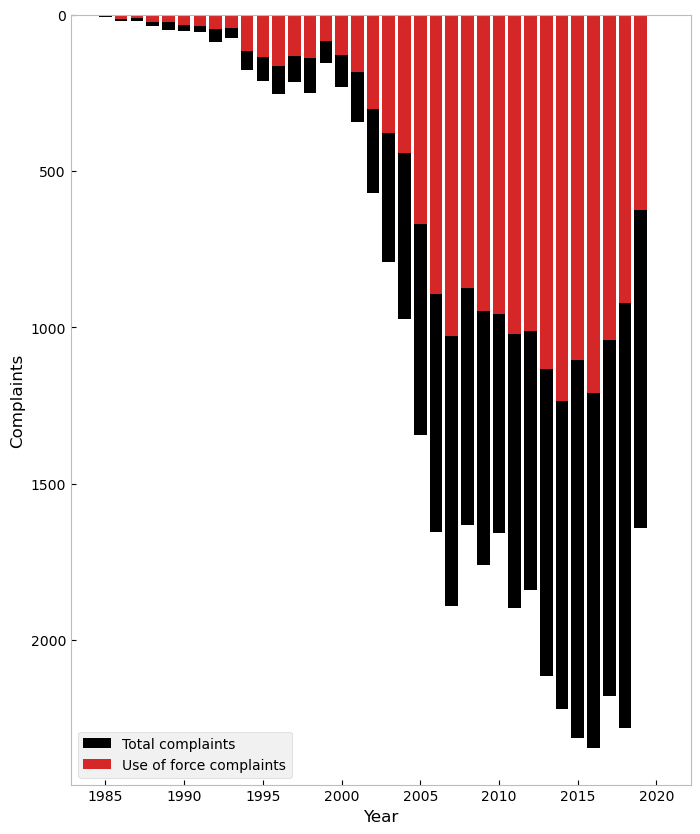

In [648]:
#y = 'contact_reason'
plt.figure(figsize=(8,10))
x = 'year_received'
xvec = list(set(df[x].unique()))
yvec = np.zeros(len(xvec))
for i in range(len(yvec)):
    yvec[i] = np.sum(np.array(df[x] == xvec[i]))

y2vec = np.zeros(len(xvec))
for i in range(len(yvec)):
    y2vec[i] = np.sum((np.array(df['fado_type']=='Force') + new_force)*np.array(df[x] == xvec[i]))

#plt.yscale('log')
plt.bar(xvec, yvec, color='black', label='Total complaints')
#plt.bar(xvec, yvec*0.5, linestyle='--', color='black')

plt.bar(xvec, y2vec, color='tab:red', label='Use of force complaints')
plt.gca().invert_yaxis()

plt.xlabel('Year')
plt.ylabel("Complaints")
plt.legend()
plt.grid(None)
plt.gca().set_facecolor('white')

pass

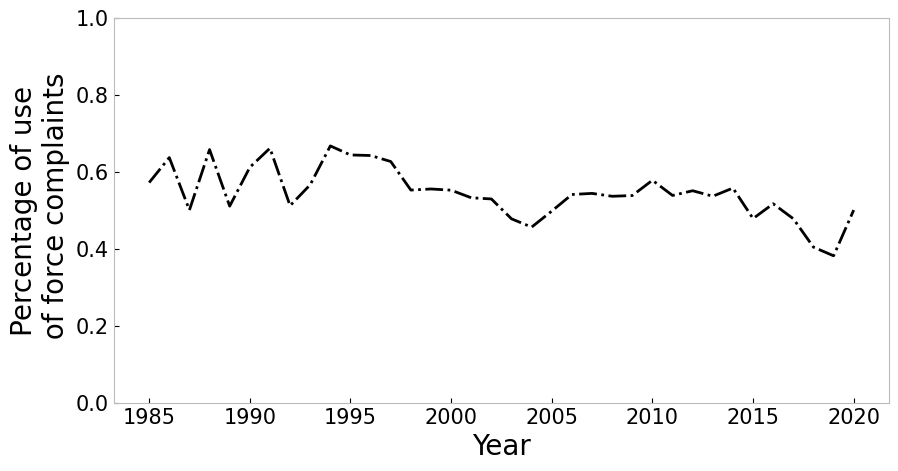

In [643]:
#y = 'contact_reason'
plt.figure(figsize=(10,5))
x = 'year_received'
xvec = list(set(df[x].unique()))
yvec = np.zeros(len(xvec))
for i in range(len(yvec)):
    yvec[i] = np.sum(np.array(df[x] == xvec[i]))

x2 = 'Force'
y2vec = np.zeros(len(xvec))
for i in range(len(yvec)):
    y2vec[i] = np.sum((np.array(df['fado_type'] ==x2)+np.array(new_force))*np.array(df[x] == xvec[i]))

#plt.yscale('log')
#plt.bar(xvec, yvec, color='navy')
#plt.bar(xvec, yvec*0.5, linestyle='--', color='black')
plt.ylim([0,1])
plt.plot(xvec, y2vec/yvec, color='k', linestyle='dashdot')

plt.xlabel('Year', fontsize=20)
plt.ylabel("Percentage of use\n of force complaints", fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.grid(None)
plt.gca().set_facecolor('white')


pass

In [ ]:
df.loc

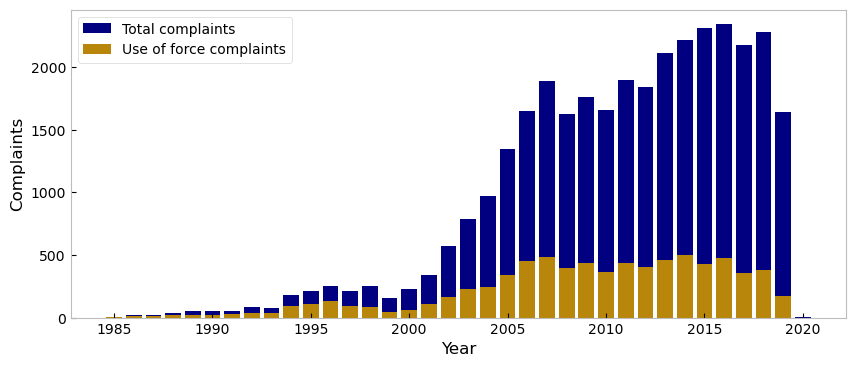

In [650]:
#y = 'contact_reason'
plt.figure(figsize=(10,4))
x = 'year_received'
xvec = list(set(df[x].unique()))
yvec = np.zeros(len(xvec))
for i in range(len(yvec)):
    yvec[i] = np.sum(np.array(df[x] == xvec[i]))

x2 = 'Abuse of Power'
y2vec = np.zeros(len(xvec))
for i in range(len(yvec)):
    y2vec[i] = np.sum(np.array(df['fado_type'] =='Force')*np.array(df[x] == xvec[i]))

#plt.yscale('log')
plt.bar(xvec, yvec, color='navy', label='Total complaints')
#plt.bar(xvec, yvec*0.5, linestyle='--', color='black')

plt.bar(xvec, y2vec, color='DarkGoldenrod', label='Use of force complaints')
#plt.axis('off')
plt.grid(None)
plt.gca().set_facecolor('white')

plt.xlabel('Year')
plt.ylabel("Complaints")
plt.legend(facecolor='white')
pass

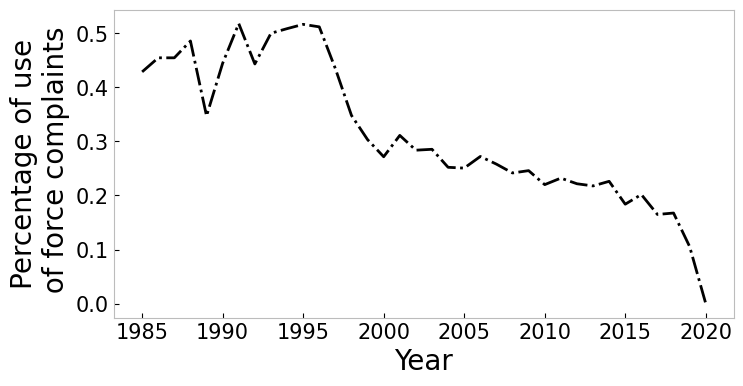

In [641]:
#y = 'contact_reason'
plt.figure(figsize=(8,4))
x = 'year_received'
xvec = list(set(df[x].unique()))
yvec = np.zeros(len(xvec))
for i in range(len(yvec)):
    yvec[i] = np.sum(np.array(df[x] == xvec[i]))

x2 = 'Force'
y2vec = np.zeros(len(xvec))
for i in range(len(yvec)):
    y2vec[i] = np.sum(np.array(df['fado_type'] ==x2)*np.array(df[x] == xvec[i]))

#plt.yscale('log')
#plt.bar(xvec, yvec, color='navy')
#plt.bar(xvec, yvec*0.5, linestyle='--', color='black')

plt.plot(xvec, y2vec/yvec, color='k', linestyle='dashdot')

plt.xlabel('Year', fontsize=20)
plt.ylabel("Percentage of use\n of force complaints", fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.grid(None)
plt.gca().set_facecolor('white')

pass

Text(0, 0.5, 'PD suspected C/V of violation/crime - street')

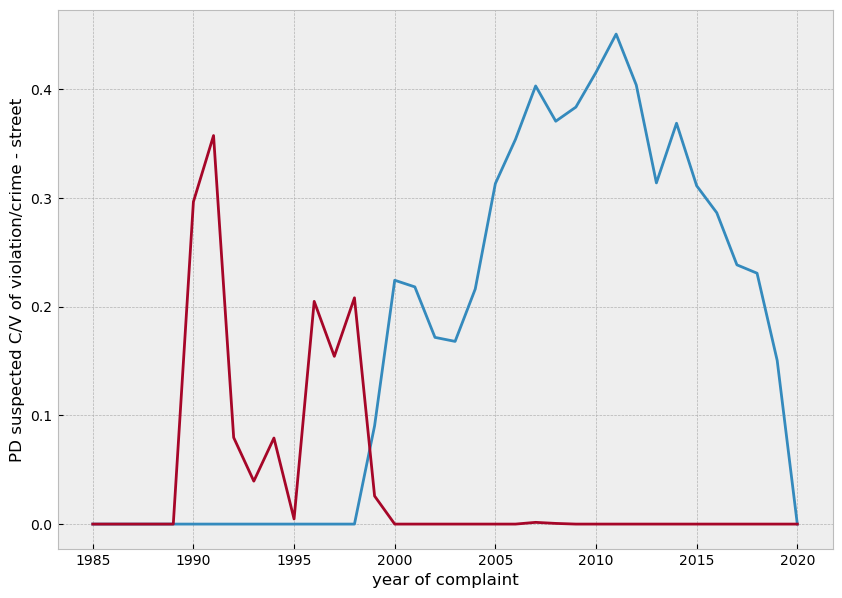

In [79]:
plt.figure(figsize=(10,7))

y = 'PD suspected C/V of violation/crime - street'
x = 'year_received'
xvec = list(set(df[x].unique()))
yvec = np.zeros(len(xvec))
for i in range(len(yvec)):
    temp_year = np.sum(np.array(df[x] == xvec[i]))
    yvec[i] = np.sum(np.array(df['contact_reason'] ==y)*np.array(df[x] == xvec[i]))/temp_year

y2 = 'Stop/Question/Frisk'
y2vec = np.zeros(len(xvec))
for i in range(len(yvec)):
    temp_year = np.sum(np.array(df[x] == xvec[i]))
    y2vec[i] = np.sum(np.array(df['contact_reason'] ==y2)*np.array(df[x] == xvec[i]))/temp_year

plt.plot(xvec, yvec)
plt.plot(xvec, y2vec)
plt.xlabel('year of complaint')
plt.ylabel(y)

In [88]:
ls data

 Volume in drive C is Windows
 Volume Serial Number is F68E-BADC

 Directory of c:\Users\Nicole\Dropbox (MIT)\spring2024\6.C85\6c85\A4\data

03/09/2024  12:48 PM    <DIR>          .
03/09/2024  11:31 AM    <DIR>          ..
03/06/2024  09:55 AM         9,553,201 allegations_202007271729.csv
03/06/2024  09:55 AM            29,192 CCRB Data Layout Table.xlsx
03/09/2024  11:14 AM            10,020 DECENNIALPL2020.P1_metadata_2022-02-06T162722.csv
03/09/2024  11:15 AM            11,859 DECENNIALPL2020.P2_metadata_2022-02-06T162757.csv
03/09/2024  12:48 PM         1,594,512 geo_export_87979e94-a789-47e3-b126-891d5d6e7e7b.shp
03/06/2024  05:47 PM            34,510 nyc_precinct_2020pop.csv
03/06/2024  09:55 AM            62,449 ReadMe _ Civilian Complaints Against New York City Police Officers.pdf
               7 File(s)     11,295,743 bytes
               2 Dir(s)  261,957,808,128 bytes free


In [95]:
nyc = gpd.read_file("data/Police Precincts.geojson") # neighborhood shape data
race = pd.read_csv("data/nyc_precinct_2020pop.csv")


In [109]:
np.min((race['P1_003N']+race['P1_004N']+race['P1_005N']+race['P1_006N']+race['P1_007N']+race['P1_008N'])/race['P1_001N'])
race_df = pd.DataFrame()
race_df['precinct'] = race['precinct']
race_df['White'] = race['P1_003N']
race_df['Black'] = race['P1_004N']
race_df['American Indian'] = race['P1_005N']
race_df['Asian'] = race['P1_006N']
race_df['Other'] = race['P1_007N']+race['P1_008N']
race_df['Total'] = race['P1_002N']

In [110]:
race_df

,precinct,White,Black,American Indian,Asian,Other,Total
0,1,57501,2655,96,14624,2061,76937
1,5,13363,3556,109,27507,3128,47663
2,6,50320,1782,72,5635,1672,59481
3,7,18416,6934,396,17779,8221,51746
4,9,41843,6610,480,11322,7857,68112
...,...,...,...,...,...,...,...
72,115,26261,10054,4894,34726,78756,154691
73,120,46574,28782,1410,14002,18947,109715
74,121,61832,17664,1517,19670,16833,117516
75,122,104075,4494,464,18771,7609,135413


In [574]:
nyc['white_percentage']=(race_df['White'])/race_df['Total']
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('white_percentage', 
              scale=alt.Scale(scheme='blueorange'),
              title = 'White proportion'),
    tooltip=['precinct:N','white_percentage:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

alt.Chart(...)

In [624]:
x = 'year_received'
xvec = list(set(df[x].unique()))
temp_count = np.zeros([len(race_df), len(xvec)])
temp_norm = np.zeros([len(race_df), len(xvec)])

for i in range(len(race_df)):
    for j in range(len(xvec)):
        temp_count[i,j] = np.sum((np.array(df['precinct'],dtype='int')==race_df['precinct'].iloc[i])*(np.array(df['fado_type']=='Force')+new_force)*np.array(df['year_received']==xvec[j]))
        temp_norm[i,j] = np.sum((np.array(df['precinct'],dtype='int')==race_df['precinct'].iloc[i])*np.array(df['year_received']==xvec[j]))

c:\Users\Nicole\anaconda3\envs\analysis\Lib\site-packages\pandas\core\series.py:893: RuntimeWarning: invalid value encountered in cast
  return np.asarray(self._values, dtype)


In [637]:
nyc['count']=np.sum(temp_count, axis=1)#/race_df['Total']#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('count', 
              scale=alt.Scale(scheme='inferno', domainMax =1000),#,#,bins=[0.1, 0.25, 0.5, 0.75, 1.0]), 
              title = 'Force complaint %'),
    tooltip=['NTAName:N','precinct:N','count:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

alt.Chart(...)

In [613]:
nyc['count']=np.nanmean(temp_count[:,np.array(xvec)>2013]/temp_norm[:,np.array(xvec)>2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('count', 
              scale=alt.Scale(scheme='viridis', domainMin=0.1, domainMax = 0.7),#,#,bins=[0.1, 0.25, 0.5, 0.75, 1.0]), 
              title = 'Force complaint %'),
    tooltip=['NTAName:N','precinct:N','count:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

C:\Users\Nicole\AppData\Local\Temp\ipykernel_8752\3849067950.py:1: RuntimeWarning: invalid value encountered in divide
  nyc['count']=np.nanmean(temp_count[:,np.array(xvec)>2013]/temp_norm[:,np.array(xvec)>2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)


alt.Chart(...)

In [614]:
nyc['count']=np.nanmean(temp_count[:,np.array(xvec)<=2013]/temp_norm[:,np.array(xvec)<=2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('count', 
              scale=alt.Scale(scheme='viridis', domainMin=0.1, domainMax = 0.7),#,#,bins=[0.1, 0.25, 0.5, 0.75, 1.0]), 
              title = 'Force complaint %'),
    tooltip=['NTAName:N','precinct:N','count:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

C:\Users\Nicole\AppData\Local\Temp\ipykernel_8752\4286583454.py:1: RuntimeWarning: invalid value encountered in divide
  nyc['count']=np.nanmean(temp_count[:,np.array(xvec)<=2013]/temp_norm[:,np.array(xvec)<=2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)


alt.Chart(...)

In [638]:
x = 'year_received'
xvec = list(set(df[x].unique()))
temp_count = np.zeros([len(race_df), len(xvec)])
temp_norm = np.zeros([len(race_df), len(xvec)])

for i in range(len(race_df)):
    for j in range(len(xvec)):
        temp_count[i,j] = np.sum((np.array(df['precinct'],dtype='int')==race_df['precinct'].iloc[i])*np.array(df['fado_type']=='Force')*np.array(df['year_received']==xvec[j]))
        temp_norm[i,j] = np.sum((np.array(df['precinct'],dtype='int')==race_df['precinct'].iloc[i])*np.array(df['year_received']==xvec[j]))

c:\Users\Nicole\anaconda3\envs\analysis\Lib\site-packages\pandas\core\series.py:893: RuntimeWarning: invalid value encountered in cast
  return np.asarray(self._values, dtype)


In [ ]:
df['']

In [640]:
nyc['count']=np.sum(temp_count, axis=1)#/race_df['Total']#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('count', 
              scale=alt.Scale(scheme='inferno', domainMax =1000, type='log'),#,#,bins=[0.1, 0.25, 0.5, 0.75, 1.0]), 
              title = 'Force complaint %'),
    tooltip=['NTAName:N','precinct:N','count:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

alt.Chart(...)

In [616]:
nyc['count']=np.nanmean(temp_count[:,np.array(xvec)>2013]/temp_norm[:,np.array(xvec)>2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('count', 
              scale=alt.Scale(scheme='viridis', domainMin=0.1, domainMax = 0.7),#,#,bins=[0.1, 0.25, 0.5, 0.75, 1.0]), 
              title = 'Force complaint %'),
    tooltip=['NTAName:N','precinct:N','count:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

C:\Users\Nicole\AppData\Local\Temp\ipykernel_8752\3849067950.py:1: RuntimeWarning: invalid value encountered in divide
  nyc['count']=np.nanmean(temp_count[:,np.array(xvec)>2013]/temp_norm[:,np.array(xvec)>2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)


alt.Chart(...)

In [617]:
nyc['count']=np.nanmean(temp_count[:,np.array(xvec)<=2013]/temp_norm[:,np.array(xvec)<=2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('count', 
              scale=alt.Scale(scheme='viridis', domainMin=0.1, domainMax = 0.7),#,#,bins=[0.1, 0.25, 0.5, 0.75, 1.0]), 
              title = 'Force complaint %'),
    tooltip=['NTAName:N','precinct:N','count:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

C:\Users\Nicole\AppData\Local\Temp\ipykernel_8752\4286583454.py:1: RuntimeWarning: invalid value encountered in divide
  nyc['count']=np.nanmean(temp_count[:,np.array(xvec)<=2013]/temp_norm[:,np.array(xvec)<=2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)


alt.Chart(...)

In [618]:
nyc['count']=np.nanmean(temp_count[:,np.array(xvec)<=2013]/temp_norm[:,np.array(xvec)<=2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('count', 
              scale=alt.Scale(scheme='viridis', domainMin=0.1, domainMax = 0.7),#,#,bins=[0.1, 0.25, 0.5, 0.75, 1.0]), 
              title = 'Force complaint %'),
    tooltip=['NTAName:N','precinct:N','count:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

C:\Users\Nicole\AppData\Local\Temp\ipykernel_8752\4286583454.py:1: RuntimeWarning: invalid value encountered in divide
  nyc['count']=np.nanmean(temp_count[:,np.array(xvec)<=2013]/temp_norm[:,np.array(xvec)<=2013], axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)


alt.Chart(...)

In [623]:
nyc['count']=np.sum(temp_count, axis=1)/np.sum(temp_norm, axis=1)#np.sum(temp_count[:,np.array(xvec)>2013],axis=1)/np.sum(temp_norm[:,np.array(xvec)>2013],axis=1)
fig = alt.Chart(nyc).mark_geoshape(
).project(type='identity', reflectX=False, reflectY=True
    ).encode(
    alt.Color('count', 
              scale=alt.Scale(scheme='viridis'),#, domainMin=0.1, domainMax = 0.7),#,#,bins=[0.1, 0.25, 0.5, 0.75, 1.0]), 
              title = 'Force complaint %'),
    tooltip=['NTAName:N','precinct:N','count:Q']
).properties(
    width=450,
    height=450
).configure_view(strokeOpacity=0)
fig

alt.Chart(...)